In [2]:
from IPython.display import Audio
import librosa

# Load the .wav file using librosa
file_path_1 = "audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav"
sample_1, sampling_rate_1 = librosa.load(file_path_1, sr=None)

Audio(data=sample_1, rate=sampling_rate_1)

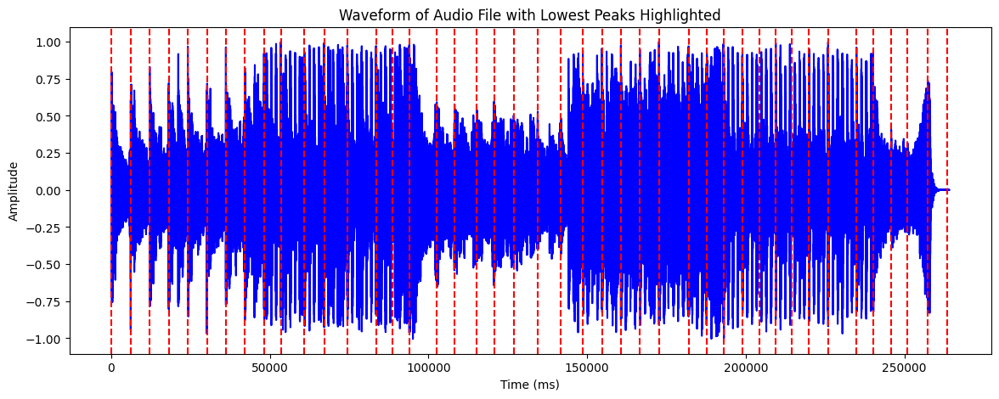

Times of the 5 lowest peaks in milliseconds:
[2.63380091e+05 2.14600000e+05 2.51005306e+05 8.85421315e+04
 2.45836689e+05 2.04218186e+05 1.41775510e+05 1.26839501e+05
 1.34419683e+05 1.15217234e+05 1.08212608e+05 1.02593651e+05
 1.20637732e+05 6.25941043e+03 3.02257596e+04 1.81270295e+04
 2.57400544e+05 1.27437642e+02 4.21270295e+04 1.21274376e+04
 4.81273923e+04 2.40127392e+05 1.87730612e+05 1.98948753e+05
 6.08956009e+04 1.48627528e+05 1.66627664e+05 2.19948889e+05
 1.54658095e+05 2.34895329e+05 3.61273923e+04 2.41273923e+04
 1.81964671e+05 8.34480726e+04 1.60627528e+05 7.43959184e+04
 9.39469841e+04 1.92947211e+05 6.70952381e+04 2.09447664e+05
 5.34478005e+04 2.25948798e+05 1.72627528e+05]


In [36]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

# Load audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# Create a time array for x-axis in milliseconds
times = np.arange(len(y)) / sr * 1000

# Plot the waveform with a specified color
plt.figure(figsize=(14, 5))
plt.plot(times, y, color='b')  # Set color to blue (b) or any desired color

# Find the 5 lowest peaks with at least 5 seconds separation
min_distance_samples = int(sr * 5)
peaks, _ = find_peaks(y, distance=min_distance_samples, height=0)

# Sort the peaks based on amplitude to get the lowest 5 peaks
lowest_peaks = peaks[np.argsort(y[peaks])[:50]]
lowest_peaks_times_ms = times[lowest_peaks]

# Plot vertical lines for the 5 lowest peaks as red dotted lines
for peak_time in lowest_peaks_times_ms:
    plt.axvline(x=peak_time, color='r', linestyle='--')

plt.title('Waveform of Audio File with Lowest Peaks Highlighted')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')
plt.show()

print("Times of the 5 lowest peaks in milliseconds:")
print(lowest_peaks_times_ms)

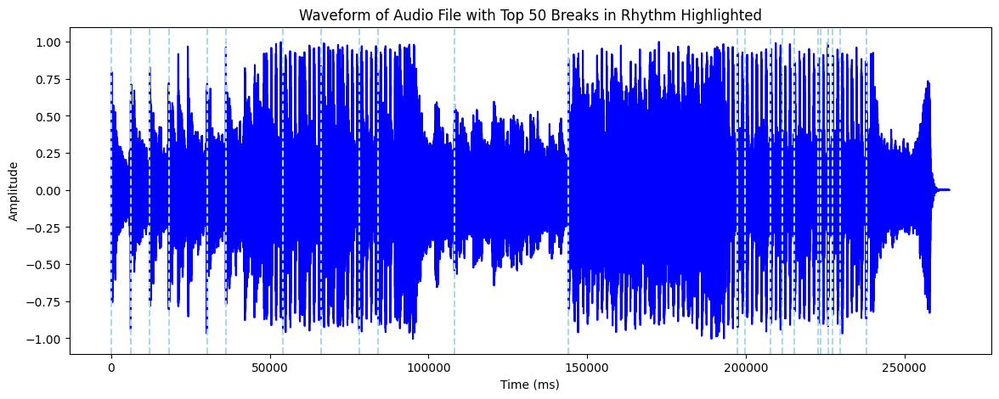

Times of the top 50 breaks in rhythm (onsets) in milliseconds:
[1.39319728e+02 6.15328798e+03 1.21440363e+04 1.81580045e+04
 3.01395011e+04 3.61534694e+04 5.41489342e+04 6.61536508e+04
 7.81583673e+04 8.41491156e+04 1.08158549e+05 1.44149478e+05
 1.97416054e+05 1.99645170e+05 2.07911474e+05 2.11649887e+05
 2.15411519e+05 2.22911565e+05 2.23654603e+05 2.25906939e+05
 2.27416236e+05 2.29645351e+05 2.37911655e+05]


In [56]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

# Load the audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# Create a time array for x-axis in milliseconds
times = np.arange(len(y)) / sr * 1000

# Find the onset envelope
onset_env = librosa.onset.onset_strength(y=y, sr=sr)

# Sort the onset envelope values in descending order
sorted_onset_env = np.sort(onset_env)[::-1]

# Find the threshold value for the top 5%
threshold_value = sorted_onset_env[int(0.002 * len(sorted_onset_env))]

# Find the frames that exceed the threshold
top_onset_frames = np.where(onset_env >= threshold_value)[0]

# Convert onset frames to times in milliseconds
top_onset_times_ms = librosa.frames_to_time(top_onset_frames, sr=sr) * 1000

# Plot the waveform and vertical lines on the same figure
plt.figure(figsize=(14, 5))

# Plot the waveform in blue
plt.plot(times, y, color='b')

# Plot vertical lines for the top 50 detected onsets (breaks in rhythm) in light blue
for onset_time in top_onset_times_ms:
    plt.axvline(x=onset_time, color='lightblue', linestyle='--')

plt.title('Waveform of Audio File with Top 50 Breaks in Rhythm Highlighted')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')
plt.show()

print("Times of the top 50 breaks in rhythm (onsets) in milliseconds:")
print(top_onset_times_ms)


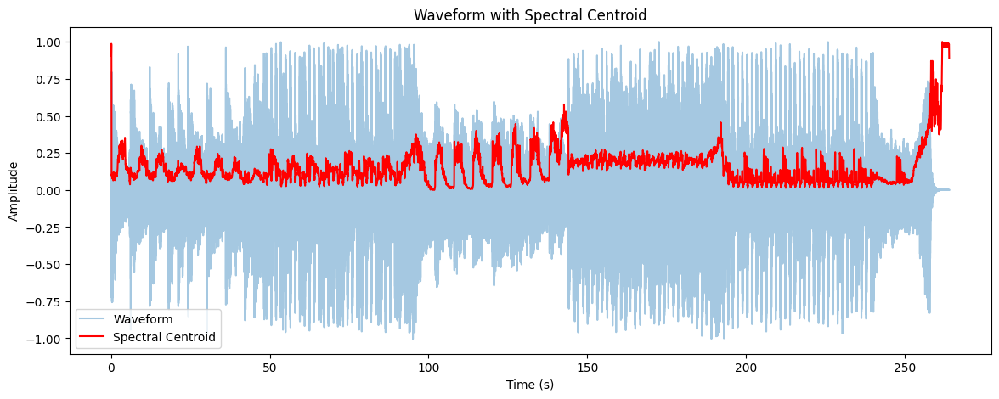

In [66]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import sklearn.preprocessing
import numpy as np

# Load the audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# The spectral centroid indicates at which frequency the energy of a spectrum is centered upon.
spectral_centroids = librosa.feature.spectral_centroid(y=y, sr=sr)[0]

# Compute the time variable
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames, sr=sr)

# Define a helper function to normalize the spectral centroid
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

# Plot the waveform without altering it along with the spectral centroid
plt.figure(figsize=(14, 5))

# Plot the original waveform
plt.plot(np.arange(len(y)) / sr, y, alpha=0.4, label='Waveform')

# Plot the spectral centroid without altering the original waveform
plt.plot(t, normalize(spectral_centroids), color='r', label='Spectral Centroid')

plt.title('Waveform with Spectral Centroid')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.legend()
plt.show()


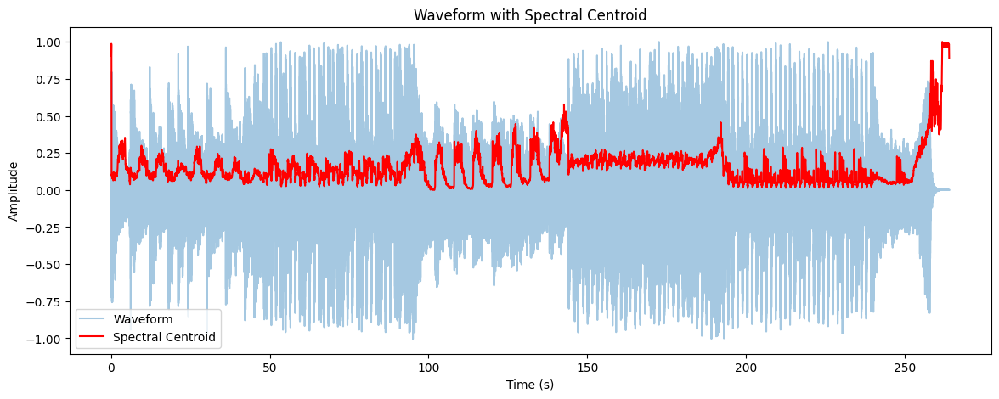

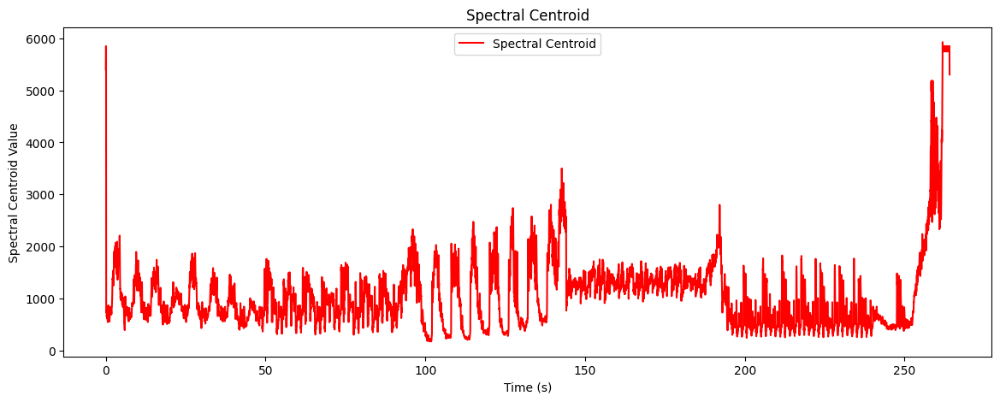

In [80]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import sklearn.preprocessing
import numpy as np

# Load the audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# The spectral centroid indicates at which frequency the energy of a spectrum is centered upon.
spectral_centroids = librosa.feature.spectral_centroid(y=y, sr=sr)[0]

# Save the values of the spectral centroid as a numpy array
np.save('spectral_centroids.npy', spectral_centroids)

# Compute the time variable
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames, sr=sr)

# Define a helper function to normalize the spectral centroid
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

# Plot the waveform without altering it along with the spectral centroid
plt.figure(figsize=(14, 5))

# Plot the original waveform
plt.plot(np.arange(len(y)) / sr, y, alpha=0.4, label='Waveform')

# Plot the spectral centroid without altering the original waveform
plt.plot(t, normalize(spectral_centroids), color='r', label='Spectral Centroid')

plt.title('Waveform with Spectral Centroid')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.legend()
plt.show()

# Create a second plot for the spectral centroid by itself
plt.figure(figsize=(14, 5))
plt.plot(t, spectral_centroids, color='r', label='Spectral Centroid')
plt.title('Spectral Centroid')
plt.xlabel('Time (s)')
plt.ylabel('Spectral Centroid Value')
plt.legend()
plt.show()


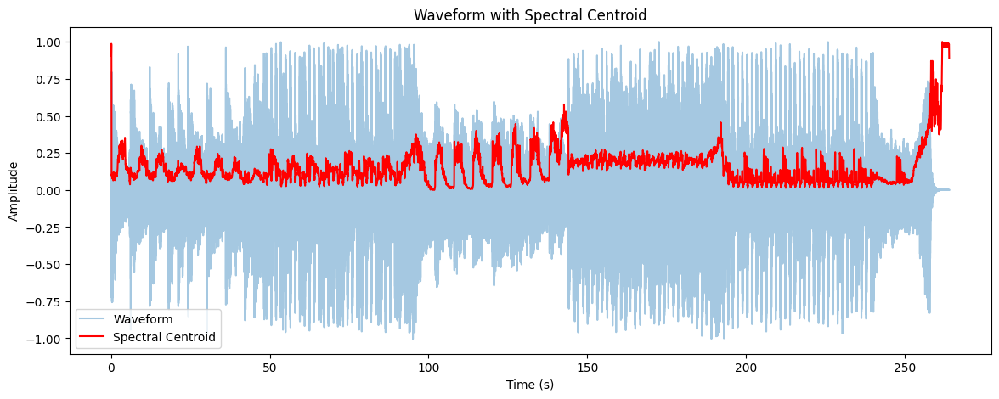

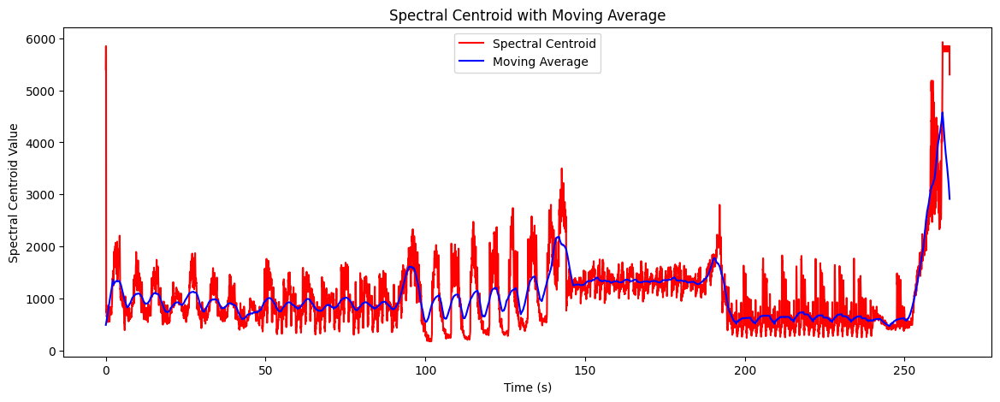

In [89]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import sklearn.preprocessing
import numpy as np

# Load the audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# The spectral centroid indicates at which frequency the energy of a spectrum is centered upon.
spectral_centroids = librosa.feature.spectral_centroid(y=y, sr=sr)[0]

# Save the values of the spectral centroid as a numpy array
np.save('spectral_centroids.npy', spectral_centroids)

# Compute the time variable
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames, sr=sr)

# Define a helper function to normalize the spectral centroid
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

# Plot the waveform without altering it along with the spectral centroid
plt.figure(figsize=(14, 5))

# Plot the original waveform
plt.plot(np.arange(len(y)) / sr, y, alpha=0.4, label='Waveform')

# Plot the spectral centroid without altering the original waveform
plt.plot(t, normalize(spectral_centroids), color='r', label='Spectral Centroid')

plt.title('Waveform with Spectral Centroid')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.legend()
plt.show()

# Create a second plot for the spectral centroid by itself with moving average
plt.figure(figsize=(14, 5))

# Calculate the 3-second moving average as the height of the spectral centroid
window_size = int(100 * sr / len(spectral_centroids))
moving_average = np.convolve(spectral_centroids, np.ones(window_size) / window_size, mode='same')

# Plot the spectral centroid in red
plt.plot(t, spectral_centroids, color='r', label='Spectral Centroid')

# Plot the moving average as the height of the spectral centroid in blue
plt.plot(t, moving_average, color='b', label='Moving Average')

plt.title('Spectral Centroid with Moving Average')
plt.xlabel('Time (s)')
plt.ylabel('Spectral Centroid Value')
plt.legend()
plt.show()

In [117]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import sklearn.preprocessing
import numpy as np
from ipywidgets import interact, widgets

# Load the audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# The spectral centroid indicates at which frequency the energy of a spectrum is centered upon.
spectral_centroids = librosa.feature.spectral_centroid(y=y, sr=sr)[0]

# Save the values of the spectral centroid as a numpy array
np.save('spectral_centroids.npy', spectral_centroids)

# Compute the time variable
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames, sr=sr)

# Define a helper function to normalize the spectral centroid
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

# Define the interactive function with a slider to adjust window_size
@interact(window_multiplier=widgets.FloatSlider(value=400, min=5, max=5700, step=50, description='Window Multiplier'))
def plot_spectral_centroid(window_multiplier):
    window_size = int(window_multiplier * sr / len(spectral_centroids))
    
    # Calculate the 3-second moving average as the height of the spectral centroid
    moving_average = np.convolve(spectral_centroids, np.ones(window_size) / window_size, mode='same')

    # Plot the spectral centroid in red
    plt.figure(figsize=(14, 5))
    plt.plot(t, spectral_centroids, color='r', label='Spectral Centroid')

    # Plot the moving average as the height of the spectral centroid in blue
    plt.plot(t, moving_average, color='b', label='Moving Average')

    plt.title('Spectral Centroid with Moving Average')
    plt.xlabel('Time (s)')
    plt.ylabel('Spectral Centroid Value')
    plt.legend()
    plt.show()

# # Run the interactive plot
# interact(plot_spectral_centroid, window_multiplier=widgets.FloatSlider(value=400, min=50, max=1000, step=50, description='Window Multiplier'))


interactive(children=(FloatSlider(value=400.0, description='Window Multiplier', max=5700.0, min=5.0, step=50.0…

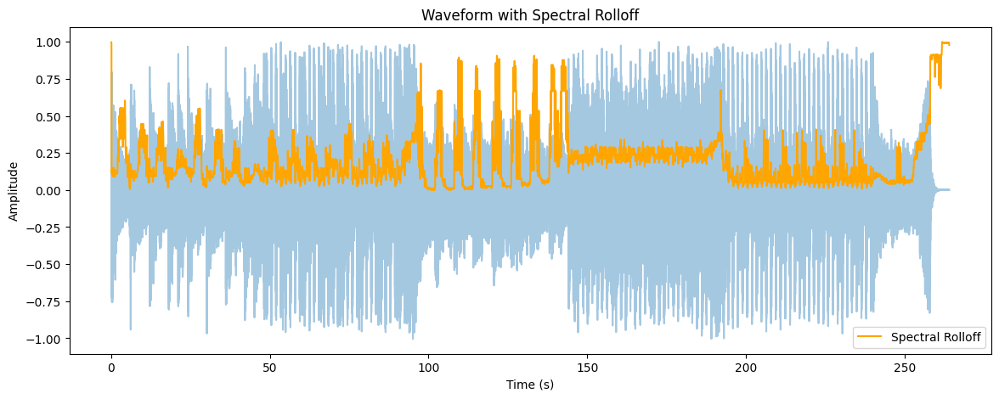

In [111]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import sklearn.preprocessing
import numpy as np

# Load the audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# Compute the magnitude spectrogram
D = np.abs(librosa.stft(y))

# Ensure that there are no negative values in the magnitude spectrogram
D = np.maximum(D, 1e-10)

# Compute the spectral rolloff
spectral_rolloff = librosa.feature.spectral_rolloff(S=D, sr=sr)[0]

# Compute the time variable based on the original audio signal
t = librosa.times_like(spectral_rolloff)

# Define a helper function to normalize the spectral rolloff
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

# Plot the waveform without altering it along with the spectral rolloff
plt.figure(figsize=(14, 5))

# Plot the original waveform
plt.plot(np.arange(len(y)) / sr, y, alpha=0.4)

# Plot the spectral rolloff without altering the original waveform
plt.plot(t, normalize(spectral_rolloff), color='orange', label='Spectral Rolloff')

plt.title('Waveform with Spectral Rolloff')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.legend()
plt.show()


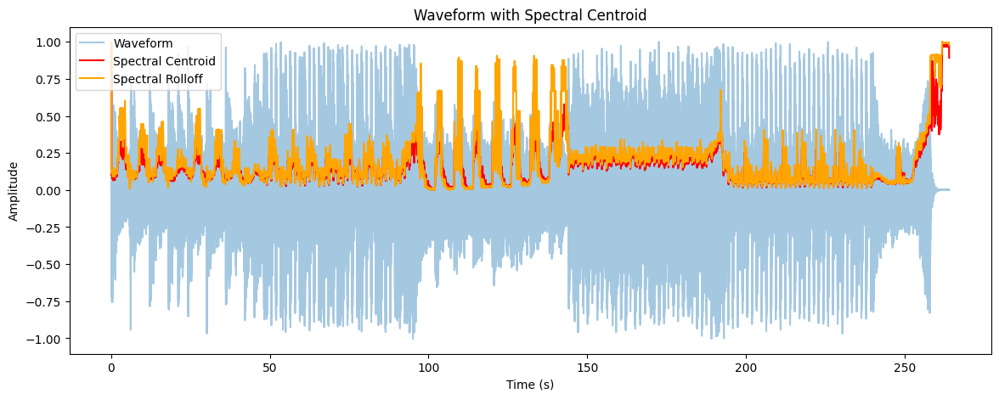

In [112]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import sklearn.preprocessing
import numpy as np

# Load the audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# The spectral centroid indicates at which frequency the energy of a spectrum is centered upon.
spectral_centroids = librosa.feature.spectral_centroid(y=y, sr=sr)[0]

# Save the values of the spectral centroid as a numpy array
np.save('spectral_centroids.npy', spectral_centroids)

# Compute the time variable
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames, sr=sr)

# Define a helper function to normalize the spectral centroid
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

# Plot the waveform without altering it along with the spectral centroid
plt.figure(figsize=(14, 5))

# Plot the original waveform
plt.plot(np.arange(len(y)) / sr, y, alpha=0.4, label='Waveform')

# Plot the spectral centroid without altering the original waveform
plt.plot(t, normalize(spectral_centroids), color='r', label='Spectral Centroid')

# Compute the magnitude spectrogram
D = np.abs(librosa.stft(y))

# Ensure that there are no negative values in the magnitude spectrogram
D = np.maximum(D, 1e-10)

# Compute the spectral rolloff
spectral_rolloff = librosa.feature.spectral_rolloff(S=D, sr=sr)[0]

# Plot the spectral rolloff without altering the original waveform
plt.plot(t, normalize(spectral_rolloff), color='orange', label='Spectral Rolloff')

plt.title('Waveform with Spectral Centroid')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.legend()
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


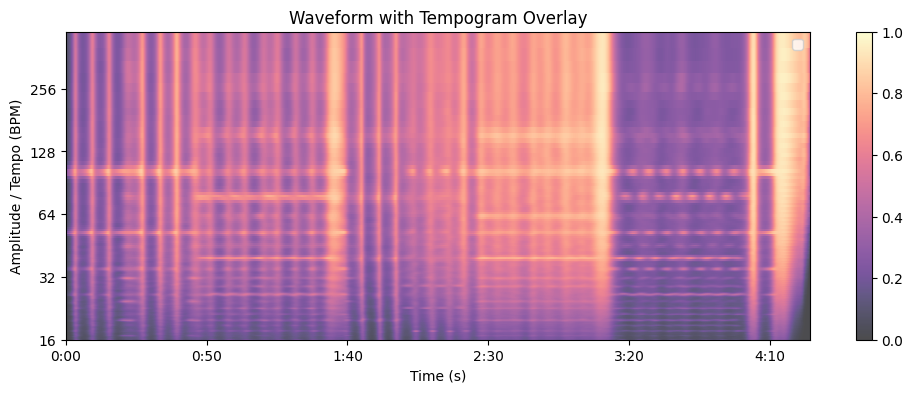

In [201]:
import librosa
import matplotlib.pyplot as plt
import librosa.display

# Load the audio file
y, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

# Compute the tempogram
tempogram = librosa.feature.tempogram(y=y, sr=sr)

# Plot the waveform with light blue overlay
plt.figure(figsize=(12, 4))


librosa.display.specshow(tempogram, x_axis='time', y_axis='tempo', cmap='magma', alpha=0.7)
plt.colorbar()
plt.title('Waveform with Tempogram Overlay')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude / Tempo (BPM)')
plt.legend()
plt.show()


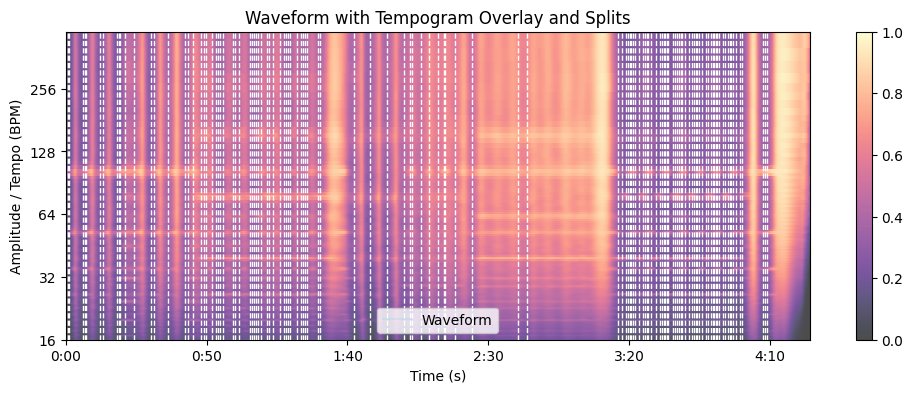

In [200]:
import librosa
import matplotlib.pyplot as plt
import librosa.display
import numpy as np

# Load the audio file
y, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

# Compute the tempogram
tempogram = librosa.feature.tempogram(y=y, sr=sr)

# Create splits based on the tempogram
onset_env = librosa.onset.onset_strength(y=y, sr=sr)
threshold = 1.5 * np.median(onset_env)
onset_frames = librosa.onset.onset_detect(onset_envelope=onset_env, backtrack=False, pre_max=20, post_max=20, pre_avg=200, post_avg=200, delta=0.2, wait=0)

# Plot the waveform with light blue overlay and splits
plt.figure(figsize=(12, 4))

# Overlay the tempogram
librosa.display.specshow(tempogram, x_axis='time', y_axis='tempo', cmap='magma', alpha=0.7)
plt.colorbar()

# Overlay the waveform with light blue color
plt.plot(np.linspace(0, len(y) / sr, len(y)), y, color='lightblue', alpha=0.4, label='Waveform')

# Plot vertical lines at split times with the lightest color
for onset_frame in onset_frames:
    onset_time = librosa.frames_to_time(onset_frame, sr=sr)
    plt.axvline(x=onset_time, color='white', linestyle='--', linewidth=1)

plt.title('Waveform with Tempogram Overlay and Splits')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude / Tempo (BPM)')
plt.legend()
plt.show()


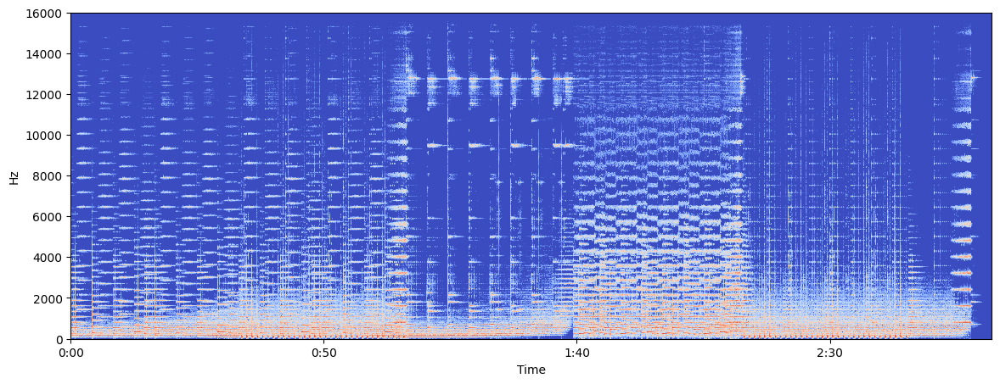

In [205]:
# Load the audio file
X, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

X = librosa.stft(X)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=32000, x_axis='time', y_axis='hz')

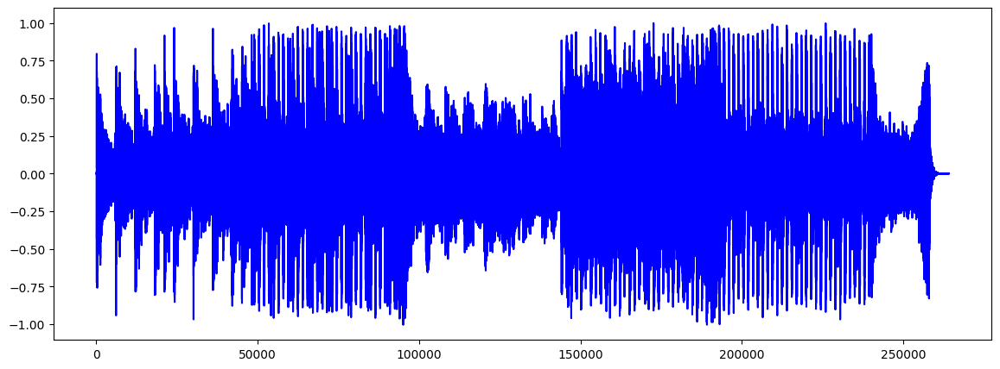

In [207]:
# Create a time array for x-axis in milliseconds
times = np.arange(len(y)) / sr * 1000
plt.figure(figsize=(14, 5))
# Plot the waveform in blue
plt.plot(times, y, color='b')

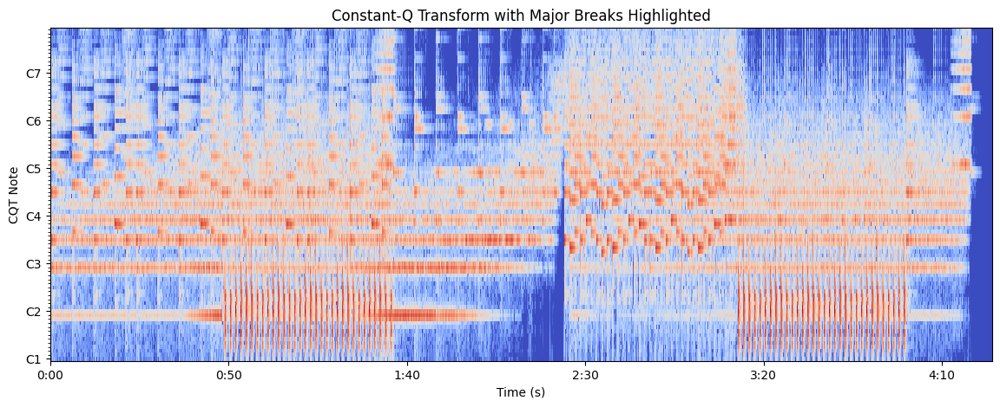

In [215]:
# power values are computed using a constant-Q transform (CQT):

# Load the audio file
X, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

# Compute the Constant-Q Transform (CQT)
CQT = librosa.amplitude_to_db(abs(librosa.cqt(X, sr=sr, hop_length=512)))

# Display the CQT
plt.figure(figsize=(14, 5))
librosa.display.specshow(CQT, sr=sr, x_axis='time', y_axis='cqt_note')

plt.title('Constant-Q Transform with Major Breaks Highlighted')
plt.xlabel('Time (s)')
plt.ylabel('CQT Note')
plt.show()


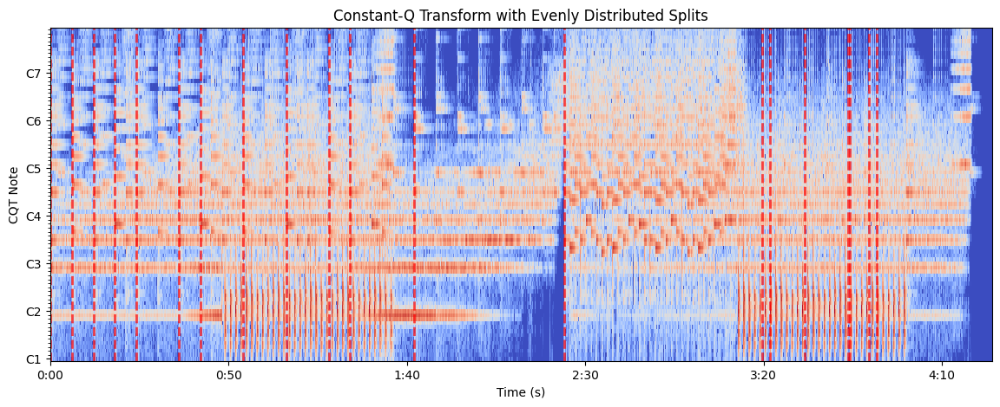

In [265]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

# Load the audio file
X, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

# Compute the Constant-Q Transform (CQT)
CQT = librosa.amplitude_to_db(abs(librosa.cqt(X, sr=sr, hop_length=512, n_bins=84, bins_per_octave=12)))

# Calculate energy changes along the time axis
energy_changes = np.mean(np.abs(np.diff(CQT, axis=1)), axis=0)

# Find the positions with the largest energy changes
split_positions = np.argsort(-energy_changes)[:20]

# Plot the CQT
plt.figure(figsize=(14, 5))
librosa.display.specshow(CQT, sr=sr, x_axis='time', y_axis='cqt_note')

# Plot vertical lines at split positions
split_times = librosa.frames_to_time(split_positions, sr=sr, hop_length=512)
for split_time in split_times:
    plt.axvline(x=split_time, color='r', linestyle='--', linewidth=2, alpha=0.7)

plt.title('Constant-Q Transform with Evenly Distributed Splits')
plt.xlabel('Time (s)')
plt.ylabel('CQT Note')
plt.show()


In [279]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display

# Load the audio file
X, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

# Compute the Constant-Q Transform (CQT)
CQT = librosa.amplitude_to_db(np.abs(librosa.cqt(X, sr=sr, hop_length=512, n_bins=84, bins_per_octave=12)))



# # Create an ipywidget for the number of energy changes
# energy_widget = widgets.IntSlider(value=20, min=1, max=50, description='Energy Changes')

@interact(energy_widget = widgets.IntSlider(value=20, min=1, max=50, description='Energy Changes'))
def plot_cqt_with_splits(energy_widget):
    # Calculate energy changes along the time axis
    energy_changes = np.mean(np.abs(np.diff(CQT, axis=1)), axis=0)
    split_positions = np.argsort(-energy_changes)[:energy_widget]
    
    # Plot the CQT
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(CQT, sr=sr, x_axis='time', y_axis='cqt_note')
    
    # Plot vertical lines at split positions
    split_times = librosa.frames_to_time(split_positions, sr=sr, hop_length=512)
    for split_time in split_times:
        plt.axvline(x=split_time, color='r', linestyle='--', linewidth=2, alpha=0.7)
    
    plt.title('Constant-Q Transform with Evenly Distributed Splits')
    plt.xlabel('Time (s)')
    plt.ylabel('CQT Note')
    plt.show()




interactive(children=(IntSlider(value=20, description='Energy Changes', max=50, min=1), Output()), _dom_classe…

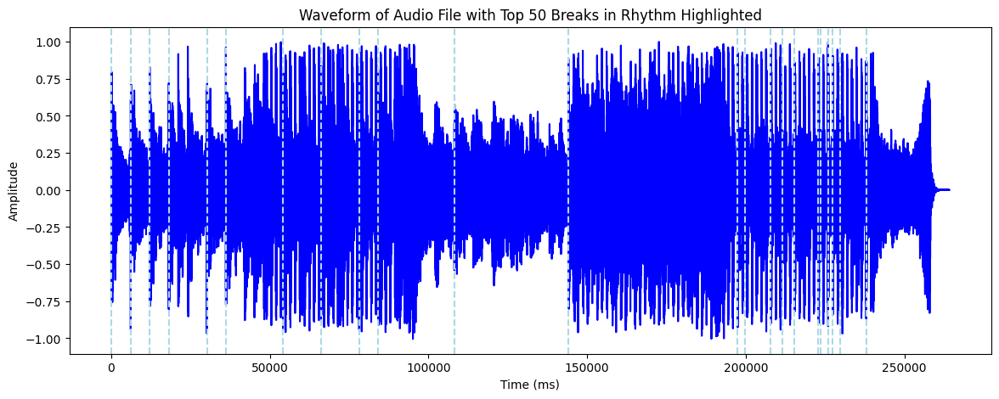

Times of the top 50 breaks in rhythm (onsets) in milliseconds:
[1.39319728e+02 6.15328798e+03 1.21440363e+04 1.81580045e+04
 3.01395011e+04 3.61534694e+04 5.41489342e+04 6.61536508e+04
 7.81583673e+04 8.41491156e+04 1.08158549e+05 1.44149478e+05
 1.97416054e+05 1.99645170e+05 2.07911474e+05 2.11649887e+05
 2.15411519e+05 2.22911565e+05 2.23654603e+05 2.25906939e+05
 2.27416236e+05 2.29645351e+05 2.37911655e+05]


In [226]:
# Load the audio file
file_path = 'audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav'
y, sr = librosa.load(file_path)

# Create a time array for x-axis in milliseconds
times = np.arange(len(y)) / sr * 1000

# Find the onset envelope
onset_env = librosa.onset.onset_strength(y=y, sr=sr)

# Sort the onset envelope values in descending order
sorted_onset_env = np.sort(onset_env)[::-1]

# Find the threshold value for the top 5%
threshold_value = sorted_onset_env[int(0.002 * len(sorted_onset_env))]

# Find the frames that exceed the threshold
top_onset_frames = np.where(onset_env >= threshold_value)[0]

# Convert onset frames to times in milliseconds
top_onset_times_ms = librosa.frames_to_time(top_onset_frames, sr=sr) * 1000

# Plot the waveform and vertical lines on the same figure
plt.figure(figsize=(14, 5))

# Plot the waveform in blue
plt.plot(times, y, color='b')

# Plot vertical lines for the top 50 detected onsets (breaks in rhythm) in light blue
for onset_time in top_onset_times_ms:
    plt.axvline(x=onset_time, color='lightblue', linestyle='--')

plt.title('Waveform of Audio File with Top 50 Breaks in Rhythm Highlighted')
plt.xlabel('Time (ms)')
plt.ylabel('Amplitude')
plt.show()

print("Times of the top 50 breaks in rhythm (onsets) in milliseconds:")
print(top_onset_times_ms)


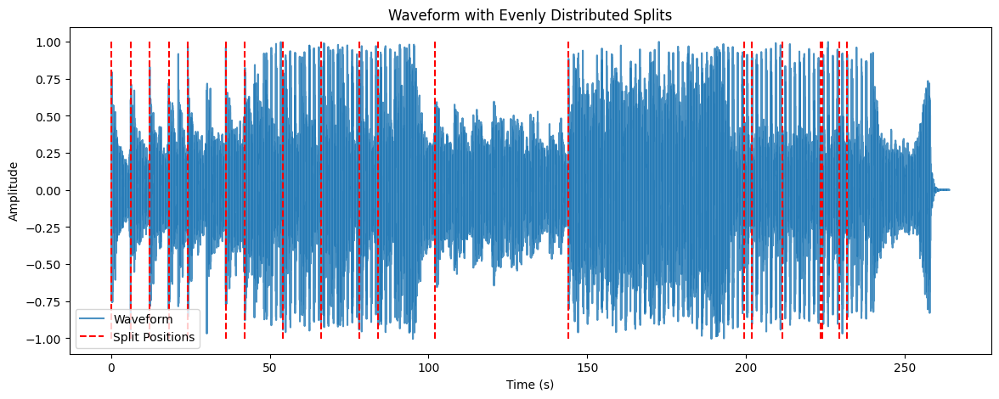

In [256]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

# Load the audio file
X, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

# Create a time array for x-axis in seconds
times = np.arange(len(X)) / sr

# Compute the Constant-Q Transform (CQT)
CQT = librosa.amplitude_to_db(abs(librosa.cqt(X, sr=sr, hop_length=512, n_bins=84, bins_per_octave=12)))

# Calculate energy changes along time axis
energy_changes = np.mean(np.abs(np.diff(CQT, axis=1)), axis=0)

# Find the positions with the largest energy changes
split_positions = np.argsort(-energy_changes)[:20]

# Plot the CQT with split positions highlighted
plt.figure(figsize=(14, 5))

# Plot the waveform with higher opacity
plt.plot(times, X, alpha=0.8, label='Waveform')

# Plot vertical lines at split positions
split_times = librosa.frames_to_time(split_positions, sr=sr, hop_length=512)
plt.vlines(split_times, ymin=np.min(X), ymax=np.max(X), color='r', linestyle='--', label='Split Positions')

plt.title('Waveform with Evenly Distributed Splits')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.legend()
plt.show()


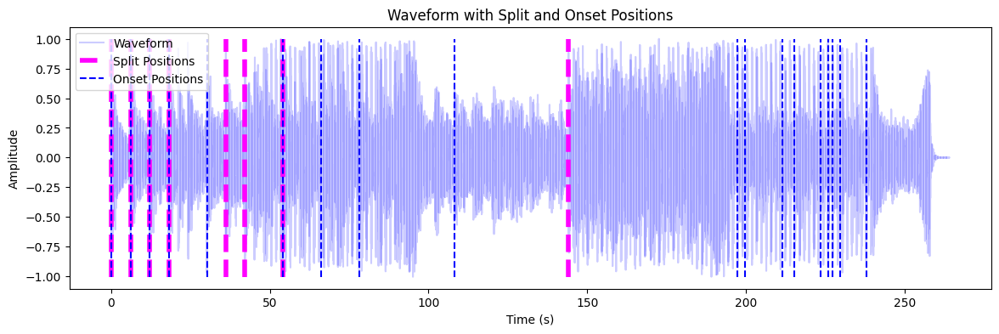

In [263]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt

# Load the audio file
X, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

# Compute the Constant-Q Transform (CQT)
CQT = librosa.amplitude_to_db(abs(librosa.cqt(X, sr=sr, hop_length=512, n_bins=84, bins_per_octave=12)))

# Calculate energy changes along time axis
energy_changes = np.mean(np.abs(np.diff(CQT, axis=1)), axis=0)

# Find the positions with the largest energy changes
split_positions = np.argsort(-energy_changes)[:8]

# Create a time array for x-axis in seconds
times = np.arange(len(X)) / sr

# Find the onset envelope
onset_env = librosa.onset.onset_strength(y=X, sr=sr)

# Sort the onset envelope values in descending order
sorted_onset_env = np.sort(onset_env)[::-1]

# Find the threshold value for the top 5%
threshold_value = sorted_onset_env[int(0.0015 * len(sorted_onset_env))]

# Find the frames that exceed the threshold
top_onset_frames = np.where(onset_env >= threshold_value)[0]

# Convert onset frames to times in seconds
onset_times = librosa.frames_to_time(top_onset_frames, sr=sr)

# Plot the waveform
plt.figure(figsize=(14, 4))
plt.plot(times, X, color='blue', alpha=0.2, label='Waveform')

# Plot vertical lines at split positions with double thickness
split_times = librosa.frames_to_time(split_positions, sr=sr, hop_length=512)
plt.vlines(split_times, ymin=min(X), ymax=max(X), color='magenta', linestyle='--', linewidth=4, label='Split Positions')

# Plot vertical lines at onset positions in purple
plt.vlines(onset_times, ymin=min(X), ymax=max(X), color='blue', linestyle='--', label='Onset Positions')

plt.title('Waveform with Split and Onset Positions')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.legend()
plt.show()


In [296]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from ipywidgets import interact, widgets
from IPython.display import display

# Load the audio file
X, sr = librosa.load('audio_mp4s/music_2024-03-06_21-00/9NJ1d7rVZTE.wav')

# Compute the Constant-Q Transform (CQT)
CQT = librosa.amplitude_to_db(np.abs(librosa.cqt(X, sr=sr, hop_length=512, n_bins=84, bins_per_octave=12)))

@interact(energy_widget = widgets.IntSlider(value=20, min=1, max=50, description='Energy Changes'),
          threshold_value = widgets.FloatSlider(value=0.0015, min=0.001, max=0.01, description='Threshold Changes'))
def plot_cqt_with_splits(energy_widget, threshold_value):
    # Create a time array for x-axis in seconds
    times = np.arange(len(X)) / sr
    
    # Find the onset envelope
    onset_env = librosa.onset.onset_strength(y=X, sr=sr)
    
    # Sort the onset envelope values in descending order
    sorted_onset_env = np.sort(onset_env)[::-1]
    
    # Calculate energy changes along the time axis
    energy_changes = np.mean(np.abs(np.diff(CQT, axis=1)), axis=0)
    split_positions = np.argsort(-energy_changes)[:energy_widget]

    # Find the frames that exceed the threshold
    top_onset_frames = np.where(onset_env >= threshold_value)[0]
    
    # Convert onset frames to times in seconds
    onset_times = librosa.frames_to_time(top_onset_frames, sr=sr)
    
    # Plot the CQT
    fig, ax = plt.subplots(figsize=(14, 5))
    # img = librosa.display.specshow(CQT, sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)

    plt.plot(times, X, color='blue', alpha=0.2, label='Waveform')

    # Find the threshold value for the top 5%
    threshold_value_total = sorted_onset_env[int(threshold_value * len(sorted_onset_env))]
    
    # Find the frames that exceed the threshold
    top_onset_frames = np.where(onset_env >= threshold_value_total)[0]
    
    # Convert onset frames to times in seconds
    onset_times = librosa.frames_to_time(top_onset_frames, sr=sr)
    
    # # Plot vertical lines at split positions
    # split_times = librosa.frames_to_time(split_positions, sr=sr, hop_length=512)
    # for split_time in split_times:
    #     plt.axvline(x=split_time, ymin=min(X), ymax=max(X), color='magenta', linestyle='--', linewidth=4)
    
    for onset_time in split_times:
        plt.axvline(x=onset_time, ymin=min(X), ymax=max(X), color='blue', linestyle='--', linewidth=2)
    
    plt.title('Waveform with Split and Onset Positions')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    
    # Set x-axis limits
    plt.xlim(times.min(), times.max())
    
    plt.legend()
    plt.show()


interactive(children=(IntSlider(value=20, description='Energy Changes', max=50, min=1), FloatSlider(value=0.00…